<a href="https://colab.research.google.com/github/madisonwong210/braille-to-speech/blob/main/Final_Proj_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Imports / Connecting to drive


In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')
import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow
import torch

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


Greyscaling the image and constructing the normal histogram of the given image and the normalized histogram



[[199 198 198 ... 120 129 132]
 [198 201 191 ... 117 127 128]
 [193 198 202 ... 122 127 112]
 ...
 [ 82  84  85 ... 162 164 165]
 [ 78  84  87 ... 156 161 166]
 [ 78  86  91 ... 177 164 178]]


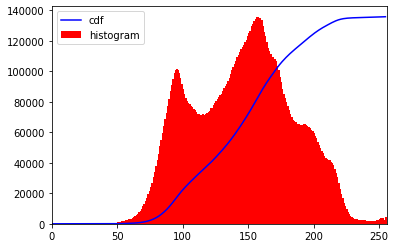

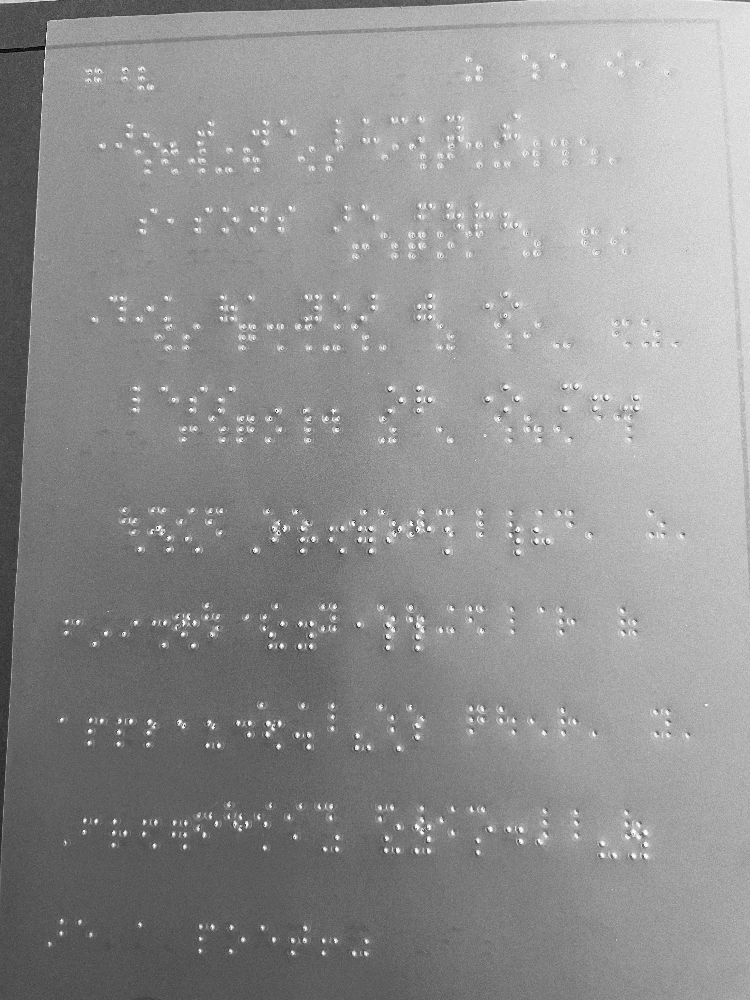

In [ ]:
img = cv.imread('gdrive/MyDrive/ECE324 Project/IMG_2562.HEIC.jpg',0)
print(img)

hist,bins = np.histogram(img.flatten(),256,[0,256])
cdf = hist.cumsum()
cdf_normalized = cdf * float(hist.max()) / cdf.max()
plt.plot(cdf_normalized, color = 'b')
plt.hist(img.flatten(),256,[0,256], color = 'r')
plt.xlim([0,256])
plt.legend(('cdf','histogram'), loc = 'upper left')
plt.show()

cv.imwrite("img.png", img)
cv2_imshow(img)

Equalizing the histogram of the image 

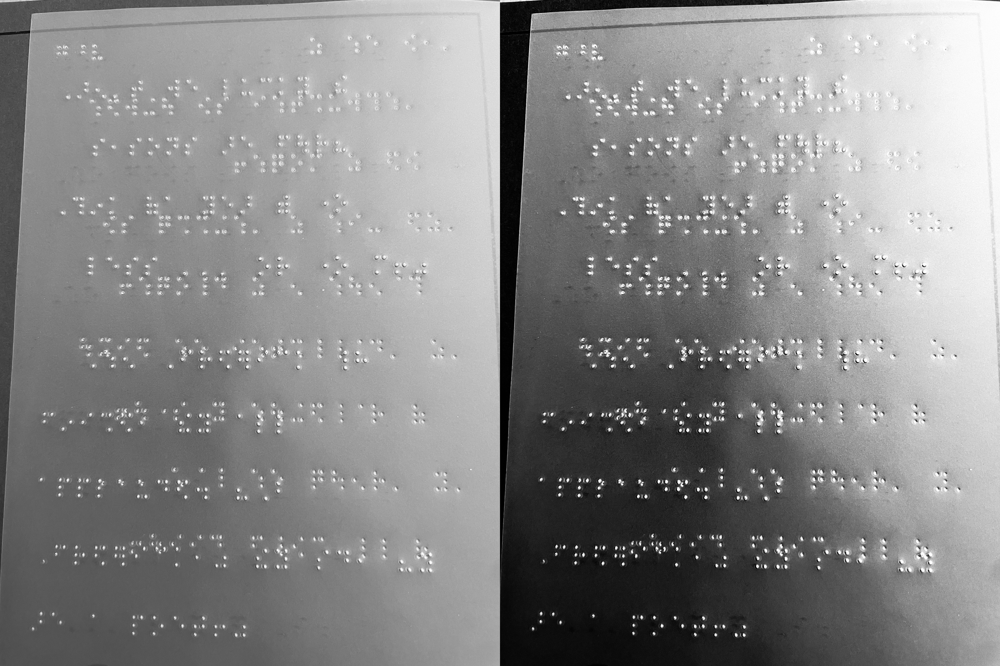

In [ ]:
equ = cv.equalizeHist(img)
res = np.hstack((img,equ)) #stacking images side-by-side
cv.imwrite('res.png',res)

cv2_imshow(res)

CLACHE (Contrast Limited Adaptive Histogram Equalization)

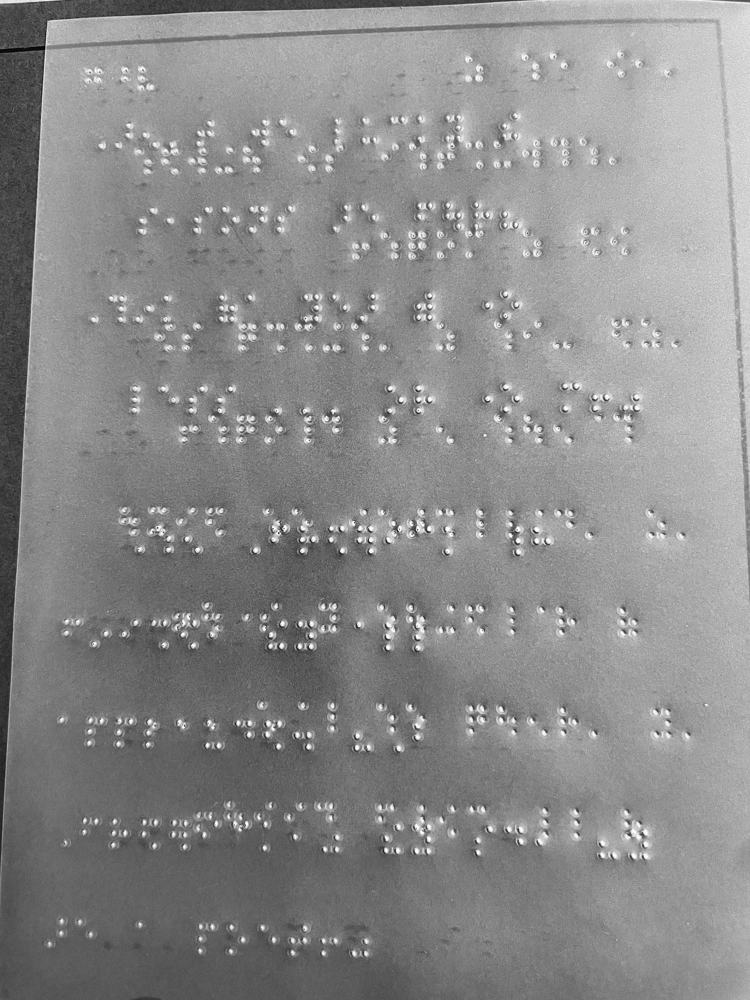

In [ ]:
clahe = cv.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
cl1 = clahe.apply(img)
cv.imwrite('clahe_2.jpg',cl1)
cv2_imshow(cl1)

First steps into making the model

In [ ]:
class ConvNet(torch.nn.Module):
  def __init__(self, number_of_channels = 1, number_of_classes = 63):
    super(ConvNet,self).__init__()
    self.conv_1 = torch.nn.Sequential(torch.nn.Conv2d(number_of_channels, 16, 2), torch.nn.ReLU())
    self.conv_2 = torch.nn.Sequential(torch.nn.Conv2d(16, 128, 2), torch.nn.ReLU())
    self.linear = torch.nn.Linear(128, number_of_classes)

  def forward(self, x):
    x = torch.nn.MaxPool2d(self.conv_1(x), 2, 2)
    x = self.conv_2(x)
  
    x = x.mean((2,3)) #<--- global average pooling 
    x = self.linear(x)
    return x

#The following line creates the CNN
model = ConvNet()